### 크롤링 조건
- 기간별
- 키워드별 

### 필요한 내용
- 게시 날짜
- 블로그명
- 본문

In [1]:
from bs4 import BeautifulSoup
import requests
import urllib.request as req

from itertools import count
from collections import OrderedDict
import re

- 네이버 블로그에서 검색 

In [42]:
'15.01.01' >= '19.01.01'

False

In [2]:
url = 'https://section.blog.naver.com/Search/Post.naver?pageNo=1&rangeType=PERIOD&orderBy=recentdate&startDate=2019-01-01&endDate=2021-05-01&keyword=%EC%84%B1%EC%8B%AC%EB%8B%B9%20%EC%97%AC%ED%96%89%20%EB%8C%80%EC%A0%84'
response = requests.get(url)

In [3]:
response

<Response [200]>

- 네이버 검색에서 검색

In [4]:
url = 'https://search.naver.com/search.naver?where=blog&query=%EC%84%B1%EC%8B%AC%EB%8B%B9%20%EC%97%AC%ED%96%89%20%EB%8C%80%EC%A0%84&sm=tab_opt&nso=so%3Ar%2Cp%3Afrom20190101to20210501'
response = requests.get(url)
response

<Response [200]>

- 두 경우 모두 response 200으로 정상 작동함을 확인.   
- 글의 개수를 확인하기 위해 네이버 블로그에서 검색하기로 한다.
    - 블로그는 검색을 못하게 막혀져있다. 
    

In [5]:
hrd = {'User=Agent':'Mozilla/5.0', 'referer': 'http://naver.com'}

In [17]:
pram = {'query' : '성심당 여행 대전'}

In [27]:
url = 'https://search.naver.com/search.naver?where=blog' #&sm=tab_opt&nso=so%3Add%2Cp%3Aall' 
response = requests.get(url, params=pram, headers=hrd) 

In [28]:
print(response)
print(response.url)
print(response.status_code)

<Response [200]>
https://search.naver.com/search.naver?where=blog&query=%EC%84%B1%EC%8B%AC%EB%8B%B9+%EC%97%AC%ED%96%89+%EB%8C%80%EC%A0%84
200


'<!doctype html> <html lang="ko"> <head> <meta charset="utf-8"> <meta name="referrer" content="always">  <meta name="format-detection" content="telephone=no,address=no,email=no"> <meta name="viewport" content="width=device-width,initial-scale=1.0,maximum-scale=2.0"> <meta property="og:title" content="성심당 여행 대전 : 네이버 블로그검색"/> <meta property="og:image" content="https://ssl.pstatic.net/sstatic/search/common/og_v3.png"> <meta property="og:description" content="\'성심당 여행 대전\'의 네이버 VIEW검색 결과입니다."> <meta name="description" lang="ko" content="\'성심당 여행 대전\'의 네이버 VIEW검색 결과입니다."> <title>성심당 여행 대전 : 네이버 블로그검색</title> <link rel="shortcut icon" href="https://ssl.pstatic.net/sstatic/search/favicon/favicon_191118_pc.ico">  <link rel="search" type="application/opensearchdescription+xml" href="https://ssl.pstatic.net/sstatic/search/opensearch-description.https.xml" title="Naver" /><link rel="stylesheet" type="text/css" href="https://ssl.pstatic.net/sstatic/search/pc/css/search1_210520.css"> <link rel="st
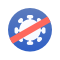
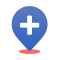
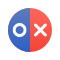
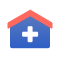

In [29]:
response.text

In [36]:
soup = BeautifulSoup(response.text, 'html.parser')

area = soup.find_all('div', {'class' : '_more_contents_evnet_base'}).find_all('a', {'class' : 'url'})
# area = soup.find_all(class_='_more_contents_evnet_base')

AttributeError: ResultSet object has no attribute 'find_all'. You're probably treating a list of elements like a single element. Did you call find_all() when you meant to call find()?

In [34]:
area

[]

<!DOCTYPE html>
 <html lang="ko"> <head> <meta charset="utf-8"/> <meta content="always" name="referrer"/> <meta content="telephone=no,address=no,email=no" name="format-detection"/> <meta content="width=device-width,initial-scale=1.0,maximum-scale=2.0" name="viewport"/> <meta content="성심당 여행 대전 : 네이버 블로그검색" property="og:title"> <meta content="https://ssl.pstatic.net/sstatic/search/common/og_v3.png" property="og:image"/> <meta content="'성심당 여행 대전'의 네이버 VIEW검색 결과입니다." property="og:description"/> <meta content="'성심당 여행 대전'의 네이버 VIEW검색 결과입니다." lang="ko" name="description"/> <title>성심당 여행 대전 : 네이버 블로그검색</title> <link href="https://ssl.pstatic.net/sstatic/search/favicon/favicon_191118_pc.ico" rel="shortcut icon"/> <link href="https://ssl.pstatic.net/sstatic/search/opensearch-description.https.xml" rel="search" title="Naver" type="application/opensearchdescription+xml"><link href="https://ssl.pstatic.net/sstatic/search/pc/css/search1_210520.css" rel="stylesheet" type="text/css"/> <link href="h
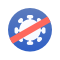
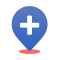
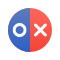
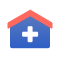

In [31]:
soup

In [40]:
# 소스코드 - 자세한 사용법은 유튜브 영상을 참조하세요.
import urllib.request
import urllib.parse
from bs4 import BeautifulSoup

plusUrl = urllib.parse.quote_plus(input('검색어를 입력하세요:'))

pageNum = 1
count = 1

i = input('몇페이지 크롤링 할까요? : ')

lastPage = int(i) * 10 - 9
while pageNum < lastPage + 1:
    url = f'https://search.naver.com/search.naver?date_from=&date_option=0&date_to=&dup_remove=1&nso=&post_blogurl=&post_blogurl_without=&query={plusUrl}&sm=tab_pge&srchby=all&st=sim&where=post&start={pageNum}'
    print(url)
    html = urllib.request.urlopen(url).read()
    soup = BeautifulSoup(html, 'html.parser')

    title = soup.find_all(class_='lst_total')

    print(f'-----{count}페이지 결과입니다.-----')
    for i in title:
#         print(i.attrs['title'])
        print(i.attrs['href'])
    print()
        
    pageNum += 10
    count += 1

검색어를 입력하세요:오월드 여행 후기
몇페이지 크롤링 할까요? : 10
https://search.naver.com/search.naver?date_from=&date_option=0&date_to=&dup_remove=1&nso=&post_blogurl=&post_blogurl_without=&query=%EC%98%A4%EC%9B%94%EB%93%9C+%EC%97%AC%ED%96%89+%ED%9B%84%EA%B8%B0&sm=tab_pge&srchby=all&st=sim&where=post&start=1
-----1페이지 결과입니다.-----


KeyError: 'href'

In [3]:
# 소스코드 - 자세한 사용법은 유튜브 영상을 참조하세요.
import urllib.request
import urllib.parse
from bs4 import BeautifulSoup

In [6]:
url = 'https://news.naver.com/main/list.nhn?mode=LSD&mid=sec&sid1=001&date=%s&page=%d'
html = urllib.request.urlopen(url).read()
soup = BeautifulSoup(html, 'html.parser')


<!DOCTYPE html>
 <html data-dark="false" lang="ko"> <head> <meta charset="utf-8"/> <title>NAVER</title> <meta content="IE=edge" http-equiv="X-UA-Compatible"/> <meta content="width=1190" name="viewport"/> <meta content="NAVER" name="apple-mobile-web-app-title"> <meta content="index,nofollow" name="robots"> <meta content="네이버 메인에서 다양한 정보와 유용한 컨텐츠를 만나 보세요" name="description"> <meta content="네이버" property="og:title"/> <meta content="https://www.naver.com/" property="og:url"/> <meta content="https://s.pstatic.net/static/www/mobile/edit/2016/0705/mobile_212852414260.png" property="og:image"/> <meta content="네이버 메인에서 다양한 정보와 유용한 컨텐츠를 만나 보세요" property="og:description"> <meta content="summary" name="twitter:card"/> <meta content="" name="twitter:title"/> <meta content="https://www.naver.com/" name="twitter:url"/> <meta content="https://s.pstatic.net/static/www/mobile/edit/2016/0705/mobile_212852414260.png" name="twitter:image"/> <meta content="네이버 메인에서 다양한 정보와 유용한 컨텐츠를 만나 보세요" name="twitter:de
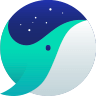
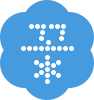

In [7]:
soup

In [44]:
soup


<!DOCTYPE html PUBLIC "-//W3C//DTD XHTML 1.0 Transitional//EN" "http://www.w3.org/TR/xhtml1/DTD/xhtml1-transitional.dtd">

<html lang="ko">
<head>
<meta content="no-cache" http-equiv="Pragma"/>
<meta content="-1" http-equiv="Expires"/>
<meta content="noindex,follow" name="robots"/>
<meta content="always" name="referrer"/>
<meta content="text/html;charset=utf-8" http-equiv="content-type"/>
<meta content="IE=edge,chrome=1" http-equiv="X-UA-Compatible"/>
<link href="/favicon.ico?3" rel="shortcut icon" type="image/x-icon"/>
<link href="https://rss.blog.naver.com/velyworld.xml" rel="alternate" title="RSS feed for velyworld Blog" type="application/rss+xml"/>
<link href="https://blog.naver.com/NBlogWlwLayout.nhn?blogId=velyworld" rel="wlwmanifest" type="application/wlwmanifest+xml"/>
<title>여행하는 아가씨, Traveling lady : 네이버 블로그</title>
</head>
<script charset="UTF-8" src="https://ssl.pstatic.net/t.static.blog/mylog/versioning/Frameset-657805386_https.js" type="text/javascript"></script>
<script

In [10]:
import requests
from bs4 import BeautifulSoup
import pandas as pd
import urllib.request

def page_get():    
    x, y = map(str, input('가져올 뉴스의 시작 날짜와 종료 날짜를 입력하세요.(예 : 19980501 20200131) :').split())
    a, b = map(int, input('시작 페이지와 종료 페이지를 입력하세요.(예 : 1 15) :').split())
    print('\n' * 2)
    
    df = pd.DataFrame(columns=['기사제목', '기사내용', '이미지링크', '기사링크'])
    df_title = []
    df_link = []
    df_img = []
    df_content = []
    
    for date in (pd.date_range(start=x, end=y).strftime("%Y%m%d").to_list()):
        for num in range(a, b+1):
            url = 'https://news.naver.com/main/list.nhn?mode=LSD&mid=sec&sid1=001&date=%s&page=%d'%(date, num)
            
            headers = {'User-Agent' : 'Mozilla/5.0'}
            html = requests.get(url, headers=headers)
            soup = BeautifulSoup(html.text)
            print(soup)
            headline = soup.find_all('dl')
            
            for item in headline:
                try:
                    title = item.find('a', {'class' : 'nclicks(fls.list)'}).find('img')['alt']
                    print('[기사 제목]')
                    print(title)
                except:
                    title = 'No Title'
                    print('No Title')
                df_title.append(title)
    
                write = item.find('a')['href']
                print('[기사 링크]')
                print(write)
                df_link.append(write)
                
                try:
                    img = item.find('dt', {"class" : "photo"}).find('img')['src']
                    print('[기사 이미지]')
                    print(img)
                except:
                    img = 'No img'
                    print('No Image')
                df_img.append(img)
    
                try:
                    content = item.find('span', {'class' : 'lede'}).text
                    print(['기사 본문'])
                    print(content)
                except:
                    content = 'No content'
                    print('No Contents')
                df_content.append(content)
                print('-' * 30)
                
    df['기사제목'] = df_title
    df['기사내용'] = df_content
    df['이미지링크'] = df_img
    df['기사링크'] = df_link
    
    df.drop_duplicates()
#     df.to_csv('../data/naver_news_multi.csv', encoding='utf-8-sig', index=False)
    
    for row in range(0, len(df)):
        try:
            img_file = df.iloc[row, 2].split("?")
            img_name = img_file[0].split("/")[-1]
            down_filename = '../data/img_file/' + img_name
    
            url = img_file[0]
            urllib.request.urlretrieve(url, down_filename)
        except:
            pass

In [11]:
page_get()

가져올 뉴스의 시작 날짜와 종료 날짜를 입력하세요.(예 : 19980501 20200131) :19980501 20200131
시작 페이지와 종료 페이지를 입력하세요.(예 : 1 15) :1 2



<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

No Image
['기사 본문']
(서울=연합) 金鍾泌총리서리는 10일 "이번 지방선거로 정계를 변화시킬 만한 기틀이 마련됐다"면서 "이제 대통령이 소신껏 일할  …
------------------------------
No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004390378
No Image
['기사 본문']
(베이징=연합) 李敦琯특파원 = 중국은 최근 일부 외국은행에 대해 제한적인 중국 채권시장 접근을 허용했다고 新華통신이 10일 보 …
------------------------------
No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004387778
No Image
['기사 본문']
(타이베이=연합)趙誠大특파원= 수 완장(蕭萬長) 타이완(臺灣) 행정원장(총리)은 10일 지난 92년 단절된 한국과의 외교관계를  …
------------------------------
No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004385385
No Image
['기사 본문']
(부산=연합) 曺廷鎬기자 = 부산시는 10일 납세자들의 편의를 위해 전국 처음으로 지방세의 신용카드 할부납부제를 도입했다. 할부 …
------------------------------
No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004382301
No Image
['기사 본문']
(도쿄=연합) 李洪奇특파원 = 일본에서 한국을 하룻동안 관광하고 돌아오는 `당일치기' 여행상품이 등장했다. 일본철도(JR) 직영 …

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

해 (울산=연합) 張榮殷기자 = 4일 오후 8시30분께 울산시 남구 옥동 울주군청 맞은 편 4층 상가내 2층 서라벌 의원(원장  …
------------------------------
No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004282175
No Image
['기사 본문']
(모스크바=연합) 池一于특파원= 한국이 포항제철과 한국통신 등 11개 공기업을 민영화하기로 함으로써 아시아가 `숨을 돌릴 수'  …
------------------------------
No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004279144
No Image
['기사 본문']
(울산=연합) 張榮殷기자 = 4일 오후 5시30분께 울산시 중구 옥교동 울산교 아래 태화강 물위에서 李재환씨(44.무직.경남 진 …
------------------------------
No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004285645
No Image
['기사 본문']
(서울=연합) 金大中대통령과 金宇中전경련회장대행을 비롯한 전경련 회장단은 4일 대기업간 사업교환(빅 딜)을 포함한 기업구조조정  …
------------------------------
No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004279793
No Image
['기사 본문']
적자 확대 및 세제개편 (서울=연합) 李京旭기자 = 정부와 정치권이 4일 마련한 재정적자 규모 대폭 확대와 이자소득세율 인상 및 …
------------------

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

No Title
[기사 링크]
https://news.naver.com/main/read.nhn?mode=LSD&mid=sec&sid1=001&oid=001&aid=0004285457
No Image
['기사 본문']
전>(일요용) (서울=연합) 金炳洙기자= 오는 9월말로 예정된 금강산 관광유람선 취항을 앞두고 한나라당 의원들간에 출항지 결정을 …
------------------------------
<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:ti

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

<!DOCTYPE HTML>
<html lang="ko">
<head>
<meta charset="utf-8"/>
<meta content="IE=edge" http-equiv="X-UA-Compatible"/>
<meta contents="always" name="referrer"/>
<meta content="600" http-equiv="refresh"/>
<meta content="width=1106" name="viewport"/>
<meta content="언론사별 속보 뉴스" property="og:title"/>
<meta content="website" property="og:type"/>
<meta content="http://news.naver.com/main/list.nhn?mode=LSD&amp;mid=sec&amp;sid=001" property="og:url"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" property="og:image"/>
<meta content="언론사별 속보 뉴스를 제공합니다." property="og:description"/>
<meta content="네이버" property="og:article:author"/>
<meta content="summary" name="twitter:card"/>
<meta content="언론사별 속보 뉴스" name="twitter:title"/>
<meta content="네이버 뉴스" name="twitter:site"/>
<meta content="네이버 뉴스" name="twitter:creator"/>
<meta content="https://ssl.pstatic.net/static.news/image/news/ogtag/navernews_200x200_20160804.png" name="twitter:image"/>
<met

KeyboardInterrupt: 